In [1]:
pwd

'C:\\Users\\Damodar Reddy\\project'

In [2]:
import numpy as np 
import pandas as pd
import os
import matplotlib.pyplot as plt
from PIL import  Image
%matplotlib inline
import seaborn as sns
import itertools
import warnings
warnings.filterwarnings("ignore")
import io
import plotly.offline as py
py.init_notebook_mode(connected=True)
import plotly.graph_objs as go
import plotly.tools as tls
import plotly.figure_factory as ff

from sklearn.preprocessing import StandardScaler
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import LabelEncoder
from sklearn.metrics import confusion_matrix
from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import precision_recall_fscore_support
from sklearn.linear_model import LogisticRegression
from sklearn import tree
from sklearn.model_selection import StratifiedKFold
from sklearn import datasets
from sklearn.svm import SVC
from sklearn import metrics
from sklearn.feature_selection import RFE
from sklearn.feature_selection import RFECV
from sklearn.datasets import make_classification
from sklearn.metrics import classification_report 
from sklearn.metrics import roc_curve
from sklearn.model_selection import cross_val_score

In [3]:
#loading the dataset
telcom=pd.read_csv(r"C:\Users\Damodar Reddy\project\churn.csv")
file=telcom.copy()
print(telcom)

      customerID  gender  SeniorCitizen Partner Dependents  tenure  \
0     7590-VHVEG  Female              0     Yes         No       1   
1     5575-GNVDE    Male              0      No         No      34   
2     3668-QPYBK    Male              0      No         No       2   
3     7795-CFOCW    Male              0      No         No      45   
4     9237-HQITU  Female              0      No         No       2   
...          ...     ...            ...     ...        ...     ...   
7038  6840-RESVB    Male              0     Yes        Yes      24   
7039  2234-XADUH  Female              0     Yes        Yes      72   
7040  4801-JZAZL  Female              0     Yes        Yes      11   
7041  8361-LTMKD    Male              1     Yes         No       4   
7042  3186-AJIEK    Male              0      No         No      66   

     PhoneService     MultipleLines InternetService OnlineSecurity  ...  \
0              No  No phone service             DSL             No  ...   
1        

In [4]:
pd.set_option("display.max.columns", None)
pd.set_option("display.max.rows", None)

In [5]:
#data overview
print ("Rows     : " ,telcom.shape[0])
print ("Columns  : " ,telcom.shape[1])
print ("\nFeatures : \n" ,telcom.columns.tolist())
print ("\nMissing values :  ", telcom.isnull().sum().values.sum())
print ("\nUnique values :  \n",telcom.nunique())

Rows     :  7043
Columns  :  21

Features : 
 ['customerID', 'gender', 'SeniorCitizen', 'Partner', 'Dependents', 'tenure', 'PhoneService', 'MultipleLines', 'InternetService', 'OnlineSecurity', 'OnlineBackup', 'DeviceProtection', 'TechSupport', 'StreamingTV', 'StreamingMovies', 'Contract', 'PaperlessBilling', 'PaymentMethod', 'MonthlyCharges', 'TotalCharges', 'Churn']

Missing values :   0

Unique values :  
 customerID          7043
gender                 2
SeniorCitizen          2
Partner                2
Dependents             2
tenure                73
PhoneService           2
MultipleLines          3
InternetService        3
OnlineSecurity         3
OnlineBackup           3
DeviceProtection       3
TechSupport            3
StreamingTV            3
StreamingMovies        3
Contract               3
PaperlessBilling       2
PaymentMethod          4
MonthlyCharges      1585
TotalCharges        6531
Churn                  2
dtype: int64


In [6]:
print(telcom.info())

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 7043 entries, 0 to 7042
Data columns (total 21 columns):
 #   Column            Non-Null Count  Dtype  
---  ------            --------------  -----  
 0   customerID        7043 non-null   object 
 1   gender            7043 non-null   object 
 2   SeniorCitizen     7043 non-null   int64  
 3   Partner           7043 non-null   object 
 4   Dependents        7043 non-null   object 
 5   tenure            7043 non-null   int64  
 6   PhoneService      7043 non-null   object 
 7   MultipleLines     7043 non-null   object 
 8   InternetService   7043 non-null   object 
 9   OnlineSecurity    7043 non-null   object 
 10  OnlineBackup      7043 non-null   object 
 11  DeviceProtection  7043 non-null   object 
 12  TechSupport       7043 non-null   object 
 13  StreamingTV       7043 non-null   object 
 14  StreamingMovies   7043 non-null   object 
 15  Contract          7043 non-null   object 
 16  PaperlessBilling  7043 non-null   object 


In [7]:
#Replacing spaces with null values in total charges column
telcom['TotalCharges'] = telcom["TotalCharges"].replace(" ",np.nan)
#Dropping null values from total charges column which contain .15% missing data 
telcom = telcom[telcom["TotalCharges"].notnull()]
telcom = telcom.reset_index()[telcom.columns]


In [8]:
for c in telcom.columns:
    print(c, telcom[c].unique(), "\n")

customerID ['7590-VHVEG' '5575-GNVDE' '3668-QPYBK' ... '4801-JZAZL' '8361-LTMKD'
 '3186-AJIEK'] 

gender ['Female' 'Male'] 

SeniorCitizen [0 1] 

Partner ['Yes' 'No'] 

Dependents ['No' 'Yes'] 

tenure [ 1 34  2 45  8 22 10 28 62 13 16 58 49 25 69 52 71 21 12 30 47 72 17 27
  5 46 11 70 63 43 15 60 18 66  9  3 31 50 64 56  7 42 35 48 29 65 38 68
 32 55 37 36 41  6  4 33 67 23 57 61 14 20 53 40 59 24 44 19 54 51 26 39] 

PhoneService ['No' 'Yes'] 

MultipleLines ['No phone service' 'No' 'Yes'] 

InternetService ['DSL' 'Fiber optic' 'No'] 

OnlineSecurity ['No' 'Yes' 'No internet service'] 

OnlineBackup ['Yes' 'No' 'No internet service'] 

DeviceProtection ['No' 'Yes' 'No internet service'] 

TechSupport ['No' 'Yes' 'No internet service'] 

StreamingTV ['No' 'Yes' 'No internet service'] 

StreamingMovies ['No' 'Yes' 'No internet service'] 

Contract ['Month-to-month' 'One year' 'Two year'] 

PaperlessBilling ['Yes' 'No'] 

PaymentMethod ['Electronic check' 'Mailed check' 'Bank transfer

In [9]:
telcom["TotalCharges"] = telcom["TotalCharges"].astype(float)

#replace 'No internet service' to No for the following columns
replace_cols = [ 'OnlineSecurity', 'OnlineBackup', 'DeviceProtection',
                'TechSupport','StreamingTV', 'StreamingMovies']
for i in replace_cols : 
    telcom[i]  = telcom[i].replace({'No internet service' : 'No'})
    
#replace values
telcom["SeniorCitizen"] = telcom["SeniorCitizen"].replace({1:"Yes",0:"No"})


#Tenure to categorical column
def tenure_lab(telcom) :
    
    if telcom["tenure"] <= 12 :
        return "Tenure_0-12"
    elif (telcom["tenure"] > 12) & (telcom["tenure"] <= 24 ):
        return "Tenure_12-24"
    elif (telcom["tenure"] > 24) & (telcom["tenure"] <= 48) :
        return "Tenure_24-48"
    elif (telcom["tenure"] > 48) & (telcom["tenure"] <= 60) :
        return "Tenure_48-60"
    elif telcom["tenure"] > 60 :
        return "Tenure_gt_60"
telcom["tenure_group"] = telcom.apply(lambda telcom:tenure_lab(telcom),
                                      axis = 1)
#Separating churn and non churn customers
churn     = telcom[telcom["Churn"] == "Yes"]
not_churn = telcom[telcom["Churn"] == "No"]

In [10]:
telcom

,customerID,gender,SeniorCitizen,Partner,Dependents,tenure,PhoneService,MultipleLines,InternetService,OnlineSecurity,OnlineBackup,DeviceProtection,TechSupport,StreamingTV,StreamingMovies,Contract,PaperlessBilling,PaymentMethod,MonthlyCharges,TotalCharges,Churn,tenure_group
0,7590-VHVEG,Female,No,Yes,No,1,No,No phone service,DSL,No,Yes,No,No,No,No,Month-to-month,Yes,Electronic check,29.85,29.85,No,Tenure_0-12
1,5575-GNVDE,Male,No,No,No,34,Yes,No,DSL,Yes,No,Yes,No,No,No,One year,No,Mailed check,56.95,1889.50,No,Tenure_24-48
2,3668-QPYBK,Male,No,No,No,2,Yes,No,DSL,Yes,Yes,No,No,No,No,Month-to-month,Yes,Mailed check,53.85,108.15,No,Tenure_0-12
3,7795-CFOCW,Male,No,No,No,45,No,No phone service,DSL,Yes,No,Yes,Yes,No,No,One year,No,Bank transfer (automatic),42.30,1840.75,No,Tenure_24-48
4,9237-HQITU,Female,No,No,No,2,Yes,No,Fiber optic,No,No,No,No,No,No,Month-to-month,Yes,Electronic check,70.70,151.65,Yes,Tenure_0-12
5,9305-CDSKC,Female,No,No,No,8,Yes,Yes,Fiber optic,No,No,Yes,No,Yes,Yes,Month-to-month,Yes,Electronic check,99.65,820.50,Yes,Tenure_0-12
6,1452-KIOVK,Male,No,No,Yes,22,Yes,Yes,Fiber optic,No,Yes,No,No,Yes,No,Month-to-month,Yes,Credit card (automatic),89.10,1949.40,No,Tenure_12-24
7,6713-OKOMC,Female,No,No,No,10,No,No phone service,DSL,Yes,No,No,No,No,No,Month-to-month,No,Mailed check,29.75,301.90,No,Tenure_0-12
8,7892-POOKP,Female,No,Yes,No,28,Yes,Yes,Fiber optic,No,No,Yes,Yes,Yes,Yes,Month-to-month,Yes,Electronic check,104.80,3046.05,Yes,Tenure_24-48
9,6388-TABGU,Male,No,No,Yes,62,Yes,No,DSL,Yes,Yes,No,No,No,No,One year,No,Bank transfer (automatic),56.15,3487.95,No,Tenure_gt_60


In [11]:
Id_col     = ['customerID']
target_col = ["Churn"]
cat_cols   = telcom.nunique()[telcom.nunique() < 6].keys().tolist()
cat_cols   = [x for x in cat_cols if x not in target_col]
num_cols   = [x for x in telcom.columns if x not in cat_cols + target_col + Id_col]

print(Id_col)     
print(target_col) 
print(cat_cols)   
print(num_cols) 

['customerID']
['Churn']
['gender', 'SeniorCitizen', 'Partner', 'Dependents', 'PhoneService', 'MultipleLines', 'InternetService', 'OnlineSecurity', 'OnlineBackup', 'DeviceProtection', 'TechSupport', 'StreamingTV', 'StreamingMovies', 'Contract', 'PaperlessBilling', 'PaymentMethod', 'tenure_group']
['tenure', 'MonthlyCharges', 'TotalCharges']


In [12]:
# exploring data analysis

lab = telcom["Churn"].value_counts().keys().tolist()
#values
val = telcom["Churn"].value_counts().values.tolist()

trace = go.Pie(labels = lab ,
               values = val ,
               marker = dict(colors =  [ 'royalblue' ,'lime'],
                             line = dict(color = "white",
                                         width =  1.3)
                            ),
               rotation = 90,
               hoverinfo = "label+value",
               hole = .5
              )
layout = go.Layout(dict(title = "Customer attrition in data",
                        plot_bgcolor  = "rgb(243,243,243)",
                        paper_bgcolor = "rgb(243,243,243)",
                       )
                  )

data = [trace]
fig = go.Figure(data = data,layout = layout)
py.iplot(fig)

In [13]:
print(lab)
print(val)

['No', 'Yes']
[5165, 1867]


In [14]:
#function  for pie plot for customer attrition types
def plot_pie(column) :
    
    trace1 = go.Pie(values  = churn[column].value_counts().values.tolist(),
                    labels  = churn[column].value_counts().keys().tolist(),
                    hoverinfo = "label+percent+name",
                    domain  = dict(x = [0,.48]),
                    name    = "Churn Customers",
                    marker  = dict(line = dict(width = 2,
                                               color = "rgb(243,243,243)")
                                  ),
                    hole    = .6
                   )
    trace2 = go.Pie(values  = not_churn[column].value_counts().values.tolist(),
                    labels  = not_churn[column].value_counts().keys().tolist(),
                    hoverinfo = "label+percent+name",
                    marker  = dict(line = dict(width = 2,
                                               color = "rgb(243,243,243)")
                                  ),
                    domain  = dict(x = [.52,1]),
                    hole    = .6,
                    name    = "Non churn customers" 
                   )


    layout = go.Layout(dict(title = column + " distribution in customer attrition ",
                            plot_bgcolor  = "rgb(243,243,243)",
                            paper_bgcolor = "rgb(243,243,243)",
                            annotations = [dict(text = "churn customers",
                                                font = dict(size = 13),
                                                showarrow = False,
                                                x = .15, y = .5),
                                           dict(text = "Non churn customers",
                                                font = dict(size = 13),
                                                showarrow = False,
                                                x = .88,y = .5
                                               )
                                          ]
                           )
                      )
    data = [trace1,trace2]
    fig  = go.Figure(data = data,layout = layout)
    py.iplot(fig)


#function  for histogram for customer attrition types
def histogram(column) :
    trace1 = go.Histogram(x  = churn[column],
                          histnorm= "percent",
                          name = "Churn Customers",
                          marker = dict(line = dict(width = .5,
                                                    color = "black"
                                                    )
                                        ),
                         opacity = .9 
                         ) 
    
    trace2 = go.Histogram(x  = not_churn[column],
                          histnorm = "percent",
                          name = "Non churn customers",
                          marker = dict(line = dict(width = .5,
                                              color = "black"
                                             )
                                 ),
                          opacity = .9
                         )
    
    data = [trace1,trace2]
    layout = go.Layout(dict(title =column + " distribution in customer attrition ",
                            plot_bgcolor  = "rgb(243,243,243)",
                            paper_bgcolor = "rgb(243,243,243)",
                            xaxis = dict(gridcolor = 'rgb(255, 255, 255)',
                                             title = column,
                                             zerolinewidth=1,
                                             ticklen=5,
                                             gridwidth=2
                                            ),
                            yaxis = dict(gridcolor = 'rgb(255, 255, 255)',
                                             title = "percent",
                                             zerolinewidth=1,
                                             ticklen=5,
                                             gridwidth=2
                                            ),
                           )
                      )
    fig  = go.Figure(data=data,layout=layout)
    
    py.iplot(fig)

#for all categorical columns plot pie
for i in cat_cols :
    plot_pie(i)

#for all categorical columns plot histogram    
for i in num_cols :
    histogram(i)



In [15]:
#cusomer attrition in tenure groups
tg_ch  =  churn["tenure_group"].value_counts().reset_index()
tg_ch.columns  = ["tenure_group","count"]
tg_nch =  not_churn["tenure_group"].value_counts().reset_index()
tg_nch.columns = ["tenure_group","count"]

#bar - churn
trace1 = go.Bar(x = tg_ch["tenure_group"]  , y = tg_ch["count"],
                name = "Churn Customers",
                marker = dict(line = dict(width = .5,color = "black")),
                opacity = .9)

#bar - not churn
trace2 = go.Bar(x = tg_nch["tenure_group"] , y = tg_nch["count"],
                name = "Non Churn Customers",
                marker = dict(line = dict(width = .5,color = "black")),
                opacity = .9)

layout = go.Layout(dict(title = "Customer attrition in tenure groups",
                        plot_bgcolor  = "rgb(243,243,243)",
                        paper_bgcolor = "rgb(243,243,243)",
                        xaxis = dict(gridcolor = 'rgb(255, 255, 255)',
                                     title = "tenure group",
                                     zerolinewidth=1,ticklen=5,gridwidth=2),
                        yaxis = dict(gridcolor = 'rgb(255, 255, 255)',
                                     title = "count",
                                     zerolinewidth=1,ticklen=5,gridwidth=2),
                       )
                  )
data = [trace1,trace2]
fig  = go.Figure(data=data,layout=layout)
py.iplot(fig)

In [16]:
telcom[['MonthlyCharges', 'TotalCharges','tenure',"tenure_group"]]

#scatter plot monthly charges & total charges by tenure group

def plot_tenure_scatter(tenure_group,color) :
    tracer = go.Scatter(x = telcom[telcom["tenure_group"] == tenure_group]["MonthlyCharges"],
                        y = telcom[telcom["tenure_group"] == tenure_group]["TotalCharges"],
                        mode = "markers",marker = dict(line = dict(color = "black",
                                                                   width = .2),
                                                       size = 4 , color = color,
                                                       symbol = "diamond-dot",
                                                      ),
                        name = tenure_group,
                        opacity = .9
                       )
    return tracer

#scatter plot monthly charges & total charges by churn group
def plot_churncharges_scatter(churn,color) :
    tracer = go.Scatter(x = telcom[telcom["Churn"] == churn]["MonthlyCharges"],
                        y = telcom[telcom["Churn"] == churn]["TotalCharges"],
                        mode = "markers",marker = dict(line = dict(color = "black",
                                                                   width = .2),
                                                       size = 4 , color = color,
                                                       symbol = "diamond-dot",
                                                      ),
                        name = "Churn - " + churn,
                        opacity = .9
                       )
    return tracer

trace1 = plot_tenure_scatter("Tenure_0-12","#FF3300")
trace2 = plot_tenure_scatter("Tenure_12-24","#6666FF")
trace3 = plot_tenure_scatter("Tenure_24-48","#99FF00")
trace4 = plot_tenure_scatter("Tenure_48-60","#996600")
trace5 = plot_tenure_scatter("Tenure_gt_60","grey")
trace6 = plot_churncharges_scatter("Yes","red")
trace7 = plot_churncharges_scatter("No","blue")

data1   = [trace1,trace2,trace3,trace4,trace5] 
data2   = [trace7,trace6]

#layout
def layout_title(title) :
    layout = go.Layout(dict(title = title,
                            plot_bgcolor  = "rgb(243,243,243)",
                            paper_bgcolor = "rgb(243,243,243)",
                            xaxis = dict(gridcolor = 'rgb(255, 255, 255)',
                                         title = "Monthly charges",
                                         zerolinewidth=1,ticklen=5,gridwidth=2),
                            yaxis = dict(gridcolor = 'rgb(255, 255, 255)',
                                         title = "Total Charges",
                                         zerolinewidth=1,ticklen=5,gridwidth=2),
                            height = 600
                           )
                      )
    return layout

layout1  = layout_title("Monthly Charges & Total Charges by Tenure group")
layout2  = layout_title("Monthly Charges & Total Charges by Churn group")
fig1 = go.Figure(data = data1,layout = layout1)
fig2 = go.Figure(data = data2,layout = layout2)
py.iplot(fig1)
py.iplot(fig2)

In [17]:
avg_tgc = telcom.groupby(["tenure_group","Churn"])[["MonthlyCharges",
                                                    "TotalCharges"]].mean().reset_index()

#function for tracing 
def mean_charges(column,aggregate) :
    tracer = go.Bar(x = avg_tgc[avg_tgc["Churn"] == aggregate]["tenure_group"],
                    y = avg_tgc[avg_tgc["Churn"] == aggregate][column],
                    name = aggregate,marker = dict(line = dict(width = 1)),
                    text = "Churn"
                   )
    return tracer

#function for layout
def layout_plot(title,xaxis_lab,yaxis_lab) :
    layout = go.Layout(dict(title = title,
                            plot_bgcolor  = "rgb(243,243,243)",
                            paper_bgcolor = "rgb(243,243,243)",
                            xaxis = dict(gridcolor = 'rgb(255, 255, 255)',title = xaxis_lab,
                                         zerolinewidth=1,ticklen=5,gridwidth=2),
                            yaxis = dict(gridcolor = 'rgb(255, 255, 255)',title = yaxis_lab,
                                         zerolinewidth=1,ticklen=5,gridwidth=2),
                           )
                      )
    return layout
    

#plot1 - mean monthly charges by tenure groups
trace1  = mean_charges("MonthlyCharges","Yes")
trace2  = mean_charges("MonthlyCharges","No")
layout1 = layout_plot("Average Monthly Charges by Tenure groups",
                      "Tenure group","Monthly Charges")
data1   = [trace1,trace2]
fig1    = go.Figure(data=data1,layout=layout1)

#plot2 - mean total charges by tenure groups
trace3  = mean_charges("TotalCharges","Yes")
trace4  = mean_charges("TotalCharges","No")
layout2 = layout_plot("Average Total Charges by Tenure groups",
                      "Tenure group","Total Charges")
data2   = [trace3,trace4]
fig2    = go.Figure(data=data2,layout=layout2)

py.iplot(fig1)
py.iplot(fig2)

In [18]:
#customer id col
Id_col     = ['customerID']
#Target columns
target_col = ["Churn"]
#categorical columns
cat_cols   = telcom.nunique()[telcom.nunique() < 6].keys().tolist()
cat_cols   = [x for x in cat_cols if x not in target_col]
#numerical columns
num_cols   = [x for x in telcom.columns if x not in cat_cols + target_col + Id_col]
#Binary columns with 2 values
bin_cols   = telcom.nunique()[telcom.nunique() == 2].keys().tolist()
#Columns more than 2 values
multi_cols = [i for i in cat_cols if i not in bin_cols]

telcom[num_cols].describe()

,tenure,MonthlyCharges,TotalCharges
count,7032.000000,7032.000000,7032.000000
mean,32.421786,64.798208,2283.300441
std,24.545260,30.085974,2266.771362
min,1.000000,18.250000,18.800000
25%,9.000000,35.587500,401.450000
50%,29.000000,70.350000,1397.475000
75%,55.000000,89.862500,3794.737500
max,72.000000,118.750000,8684.800000


In [19]:
# datapreprocessing
from sklearn.preprocessing import LabelEncoder
from sklearn.preprocessing import StandardScaler

#Label encoding Binary columns
le = LabelEncoder()
for i in bin_cols :
    telcom[i] = le.fit_transform(telcom[i])
    
#Duplicating columns for multi value columns
telcom = pd.get_dummies(data = telcom,columns = multi_cols )

#Scaling Numerical columns
std = StandardScaler()
scaled = std.fit_transform(telcom[num_cols])
scaled = pd.DataFrame(scaled,columns=num_cols)

#dropping original values merging scaled values for numerical columns
df_telcom_og = telcom.copy()
telcom = telcom.drop(columns = num_cols,axis = 1)
telcom = telcom.merge(scaled,left_index=True,right_index=True,how = "left")



In [20]:
dd=pd.DataFrame(telcom)
dd[dd.columns[0:]].corr()['Churn'][:].sort_values(ascending=True)

tenure                                    -0.353989
Contract_Two year                         -0.301294
InternetService_No                        -0.227317
tenure_group_Tenure_gt_60                 -0.225833
TotalCharges                              -0.199634
Contract_One year                         -0.177955
OnlineSecurity                            -0.171633
TechSupport                               -0.164360
Dependents                                -0.162764
Partner                                   -0.149411
PaymentMethod_Credit card (automatic)     -0.134395
InternetService_DSL                       -0.124396
PaymentMethod_Bank transfer (automatic)   -0.118613
tenure_group_Tenure_48-60                 -0.101595
PaymentMethod_Mailed check                -0.091221
OnlineBackup                              -0.083223
tenure_group_Tenure_24-48                 -0.075536
DeviceProtection                          -0.066427
MultipleLines_No                          -0.032689
MultipleLine

In [21]:
dd[dd.columns[1:]].corr()[dd.columns[1:]][:]

,gender,SeniorCitizen,Partner,Dependents,PhoneService,OnlineSecurity,OnlineBackup,DeviceProtection,TechSupport,StreamingTV,StreamingMovies,PaperlessBilling,Churn,MultipleLines_No,MultipleLines_No phone service,MultipleLines_Yes,InternetService_DSL,InternetService_Fiber optic,InternetService_No,Contract_Month-to-month,Contract_One year,Contract_Two year,PaymentMethod_Bank transfer (automatic),PaymentMethod_Credit card (automatic),PaymentMethod_Electronic check,PaymentMethod_Mailed check,tenure_group_Tenure_0-12,tenure_group_Tenure_12-24,tenure_group_Tenure_24-48,tenure_group_Tenure_48-60,tenure_group_Tenure_gt_60,tenure,MonthlyCharges,TotalCharges
gender,1.000000,-0.001819,-0.001379,0.010349,-0.007515,-0.016328,-0.013093,-0.000807,-0.008507,-0.007124,-0.010105,-0.011902,-0.009186,0.004335,0.007515,-0.008883,0.007584,-0.011189,0.004745,-0.003251,0.007755,-0.003603,-0.015973,0.001632,0.000844,0.013199,-0.001050,-0.000649,-0.010516,-0.004319,0.016279,0.005285,-0.013779,0.000048
SeniorCitizen,-0.001819,1.000000,0.016957,-0.210550,0.008392,-0.038576,0.066663,0.059514,-0.060577,0.105445,0.119842,0.156258,0.150876,-0.136377,-0.008392,0.142996,-0.108276,0.254923,-0.182519,0.137752,-0.046491,-0.116205,-0.016235,-0.024359,0.171322,-0.152987,-0.027713,0.001860,0.020383,0.014186,-0.002407,0.015683,0.219874,0.102411
Partner,-0.001379,0.016957,1.000000,0.452269,0.018397,0.143346,0.141849,0.153556,0.120206,0.124483,0.118108,-0.013957,-0.149411,-0.130028,-0.018397,0.142561,-0.001043,0.001235,-0.000286,-0.280202,0.083067,0.247334,0.111406,0.082327,-0.083207,-0.096948,-0.305061,-0.048481,0.028468,0.105341,0.280353,0.381912,0.097825,0.319072
Dependents,0.010349,-0.210550,0.452269,1.000000,-0.001078,0.080786,0.023639,0.013900,0.063053,-0.016499,-0.038375,-0.110131,-0.162764,0.023388,0.001078,-0.024307,0.051593,-0.164101,0.138383,-0.229715,0.069222,0.201699,0.052369,0.061134,-0.149274,0.056448,-0.145379,-0.001459,0.024645,0.031419,0.118090,0.163386,-0.112343,0.064653
PhoneService,-0.007515,0.008392,0.018397,-0.001078,1.000000,-0.091676,-0.052133,-0.070076,-0.095138,-0.021383,-0.033477,0.016696,0.011485,0.315218,-1.000000,0.279530,-0.452255,0.290183,0.171817,-0.001243,-0.003142,0.004442,0.008271,-0.006916,0.002747,-0.004463,-0.006950,0.012307,-0.014778,-0.009750,0.020516,0.007877,0.248033,0.113008
OnlineSecurity,-0.016328,-0.038576,0.143346,0.080786,-0.091676,1.000000,0.283285,0.274875,0.354458,0.175514,0.187426,-0.004051,-0.171633,-0.151678,0.091676,0.098592,0.320343,-0.030506,-0.332799,-0.246844,0.100658,0.191698,0.094366,0.115473,-0.112295,-0.079918,-0.242409,-0.055662,0.007695,0.071663,0.263228,0.328297,0.296447,0.412619
OnlineBackup,-0.013093,0.066663,0.141849,0.023639,-0.052133,0.283285,1.000000,0.303058,0.293705,0.281601,0.274523,0.127056,-0.083223,-0.230724,0.052133,0.202228,0.156765,0.165940,-0.380990,-0.164393,0.084113,0.111391,0.086942,0.090455,-0.000364,-0.174075,-0.267366,-0.084081,0.023085,0.099192,0.278788,0.361138,0.441529,0.510100
DeviceProtection,-0.000807,0.059514,0.153556,0.013900,-0.070076,0.274875,0.303058,1.000000,0.332850,0.389924,0.402309,0.104079,-0.066427,-0.240847,0.070076,0.201733,0.145150,0.176356,-0.380151,-0.225988,0.102911,0.165248,0.083047,0.111252,-0.003308,-0.187325,-0.273920,-0.077332,0.044972,0.076854,0.275537,0.361520,0.482607,0.522881
TechSupport,-0.008507,-0.060577,0.120206,0.063053,-0.095138,0.354458,0.293705,0.332850,1.000000,0.277549,0.280155,0.037536,-0.164360,-0.155534,0.095138,0.100421,0.312183,-0.020299,-0.335695,-0.285491,0.096258,0.240924,0.100472,0.117024,-0.114807,-0.084631,-0.238628,-0.072019,0.022137,0.062710,0.265396,0.325288,0.338301,0.432868
StreamingTV,-0.007124,0.105445,0.124483,-0.016499,-0.021383,0.175514,0.281601,0.389924,0.277549,1.000000,0.533380,0.224241,0.063123,-0.267466,0.021383,0.257804,0.014973,0.329744,-0.414951,-0.112550,0.061930,0.072124,0.046121,0.040010,0.144747,-0.247712,-0.220761,-0.050234,0.028829,0.087969,0.198150,0.280264,0.629668,0.515709


In [22]:
correlation = telcom.corr()
#tick labels
matrix_cols = correlation.columns.tolist()
#convert to array
corr_array  = np.array(correlation)

#Plotting
trace = go.Heatmap(z = corr_array,
                   x = matrix_cols,
                   y = matrix_cols,
                   colorscale = "Viridis",
                   colorbar   = dict(title = "Pearson Correlation coefficient",
                                     titleside = "right"
                                    ) ,
                  )

layout = go.Layout(dict(title = "Correlation Matrix for variables",
                        autosize = False,
                        height  = 720,
                        width   = 800,
                        margin  = dict(r = 0 ,l = 210,
                                       t = 25,b = 210,
                                      ),
                        yaxis   = dict(tickfont = dict(size = 9)),
                        xaxis   = dict(tickfont = dict(size = 9))
                       )
                  )

data = [trace]
fig = go.Figure(data=data,layout=layout)
py.iplot(fig)

In [23]:
#splitting train and test data 
train,test = train_test_split(telcom,test_size = .25 ,random_state = 0)
    
##seperating dependent and independent variables
cols    = [i for i in telcom.columns if i not in Id_col + target_col]
train_X = train[cols]
train_Y = train[target_col]
test_X  = test[cols]
test_Y  = test[target_col]

In [24]:
# feature selection by information gain

from sklearn.feature_selection import VarianceThreshold, mutual_info_classif
mi = mutual_info_classif(train_X,train_Y)
mi = pd.Series(mi)
mi.index = train_X.columns
mi.sort_values(ascending=False, inplace = True)
print(mi)

Contract_Month-to-month                    0.086833
tenure                                     0.079478
Contract_Two year                          0.061448
tenure_group_Tenure_0-12                   0.050614
InternetService_Fiber optic                0.046367
MonthlyCharges                             0.045100
TotalCharges                               0.043337
InternetService_No                         0.041378
PaymentMethod_Electronic check             0.038126
PaperlessBilling                           0.028446
tenure_group_Tenure_gt_60                  0.023889
OnlineSecurity                             0.016156
OnlineBackup                               0.014323
SeniorCitizen                              0.014165
TechSupport                                0.012671
gender                                     0.012639
Contract_One year                          0.012545
Dependents                                 0.012523
MultipleLines_Yes                          0.009175
PaymentMetho

In [25]:
tele=telcom[['SeniorCitizen', 'PhoneService', 'OnlineSecurity', 'OnlineBackup',
       'TechSupport', 'PaperlessBilling', 'InternetService_DSL',
       'InternetService_No', 'Contract_Month-to-month', 'Contract_One year',
       'Contract_Two year', 'PaymentMethod_Electronic check', 'tenure',
       'MonthlyCharges', 'TotalCharges','customerID','Churn','InternetService_Fiber optic','PaymentMethod_Mailed check',
             'PaymentMethod_Bank transfer (automatic)','Dependents','MultipleLines_No','Partner','DeviceProtection','PaymentMethod_Credit card (automatic)']]

In [26]:
tele


,SeniorCitizen,PhoneService,OnlineSecurity,OnlineBackup,TechSupport,PaperlessBilling,InternetService_DSL,InternetService_No,Contract_Month-to-month,Contract_One year,Contract_Two year,PaymentMethod_Electronic check,tenure,MonthlyCharges,TotalCharges,customerID,Churn,InternetService_Fiber optic,PaymentMethod_Mailed check,PaymentMethod_Bank transfer (automatic),Dependents,MultipleLines_No,Partner,DeviceProtection,PaymentMethod_Credit card (automatic)
0,0,0,0,1,0,1,1,0,1,0,0,1,-1.280248,-1.161694,-9.941941e-01,7590-VHVEG,0,0,0,0,0,0,1,0,0
1,0,1,1,0,0,0,1,0,0,1,0,0,0.064303,-0.260878,-1.737398e-01,5575-GNVDE,0,0,1,0,0,1,0,1,0
2,0,1,1,1,0,1,1,0,1,0,0,0,-1.239504,-0.363923,-9.596491e-01,3668-QPYBK,0,0,1,0,0,1,0,0,0
3,0,0,1,0,1,0,1,0,0,1,0,0,0.512486,-0.747850,-1.952477e-01,7795-CFOCW,0,0,0,1,0,0,0,1,0
4,0,1,0,0,0,1,0,0,1,0,0,1,-1.239504,0.196178,-9.404575e-01,9237-HQITU,1,1,0,0,0,1,0,0,0
5,0,1,0,0,0,1,0,0,1,0,0,1,-0.995040,1.158489,-6.453692e-01,9305-CDSKC,1,1,0,0,0,0,0,1,0
6,0,1,0,1,0,1,0,0,1,0,0,0,-0.424625,0.807802,-1.473127e-01,1452-KIOVK,0,1,0,0,1,0,0,0,1
7,0,0,1,0,0,0,1,0,1,0,0,0,-0.913552,-1.165018,-8.741690e-01,6713-OKOMC,0,0,1,0,0,0,0,0,0
8,0,1,0,0,1,1,0,0,1,0,0,1,-0.180161,1.329677,3.365155e-01,7892-POOKP,1,1,0,0,0,0,1,1,0
9,0,1,1,1,0,0,1,0,0,1,0,0,1.205134,-0.287470,5.314763e-01,6388-TABGU,0,0,0,1,1,1,0,0,0


In [27]:
tele.shape[1]

25

In [28]:
#splitting train and test data 
train,test = train_test_split(tele,test_size = .25 ,random_state = 0)
    
##seperating dependent and independent variables
cols    = [i for i in tele.columns if i not in Id_col + target_col]
X_train = train[cols]
Y_train= train[target_col]
X_test = test[cols]
Y_test  = test[target_col]

In [29]:
X_test.shape[0]

1758

In [30]:
logreg = LogisticRegression()
logreg.fit(X_train, Y_train)
Y_pred_logreg = logreg.predict(X_test)
print('Logistic regression score =',round(metrics.accuracy_score(Y_test, Y_pred_logreg),2))
train_acc_logreg = round((logreg.score(X_train, Y_train)),2)
test_acc_logreg = round((logreg.score(X_test, Y_test)),2)
print("Training accuracy: %s " % train_acc_logreg)
print('Test accuracy: %s ' % test_acc_logreg)
print(classification_report(Y_test, Y_pred_logreg))
scores = cross_val_score(logreg, X_test,Y_test, cv=3, scoring='accuracy') 
print('Logistic regression of each partition\n',scores)
print('Mean score of all the scores after cross validation =',round(scores.mean(),2))

Logistic regression score = 0.81
Training accuracy: 0.8 
Test accuracy: 0.81 
              precision    recall  f1-score   support

           0       0.85      0.90      0.88      1311
           1       0.65      0.55      0.60       447

    accuracy                           0.81      1758
   macro avg       0.75      0.72      0.74      1758
weighted avg       0.80      0.81      0.80      1758

Logistic regression of each partition
 [0.81569966 0.78327645 0.79351536]
Mean score of all the scores after cross validation = 0.8


In [31]:
# model building

dtc = tree.DecisionTreeClassifier()
dtc.fit(X_train, Y_train)
Y_pred_dtc = dtc.predict(X_test)
print('decision tree score =',round(metrics.accuracy_score(Y_test, Y_pred_dtc),2))
train_acc_dtc = round((dtc.score(X_train, Y_train)),2)
test_acc_dtc = round((dtc.score(X_test, Y_test)),2)

print("Training accuracy: %s " % train_acc_dtc)
print('Test accuracy: %s ' % test_acc_dtc)
print(classification_report(Y_test, Y_pred_dtc))



decision tree score = 0.73
Training accuracy: 1.0 
Test accuracy: 0.73 
              precision    recall  f1-score   support

           0       0.82      0.81      0.82      1311
           1       0.47      0.49      0.48       447

    accuracy                           0.73      1758
   macro avg       0.65      0.65      0.65      1758
weighted avg       0.73      0.73      0.73      1758



In [32]:
from sklearn.neighbors import KNeighborsClassifier
knc = KNeighborsClassifier()
knc.fit(X_train, Y_train)
Y_pred_knc = knc.predict(X_test)
print('KNeighbors score =',round(metrics.accuracy_score(Y_test, Y_pred_knc),2))
train_acc_knc = round((knc.score(X_train, Y_train)),2)
test_acc_knc = round((knc.score(X_test, Y_test)),2)
print(classification_report(Y_test, Y_pred_knc))

print("Training accuracy: %s " % train_acc_knc)
print('Test accuracy: %s ' % test_acc_knc)

scores = cross_val_score(knc, X_train,Y_train, cv=10, scoring='accuracy') 
print('KNeighbors of each partition\n',scores)
print('Mean score of all the scores after cross validation =',round(scores.mean(),2)) 

KNeighbors score = 0.77
              precision    recall  f1-score   support

           0       0.84      0.86      0.85      1311
           1       0.55      0.51      0.53       447

    accuracy                           0.77      1758
   macro avg       0.69      0.69      0.69      1758
weighted avg       0.76      0.77      0.77      1758

Training accuracy: 0.84 
Test accuracy: 0.77 
KNeighbors of each partition
 [0.77083333 0.77840909 0.76893939 0.75189394 0.77798861 0.76850095
 0.77229602 0.74193548 0.78747628 0.79127135]
Mean score of all the scores after cross validation = 0.77


In [33]:
rfc = RandomForestClassifier()
rfc.fit(X_train, Y_train)
Y_pred_rfc= rfc.predict(X_test)
print('Random Forest score =',round(metrics.accuracy_score(Y_test, Y_pred_rfc),2))
train_acc_rfc = round((rfc.score(X_train, Y_train)),2)
test_acc_rfc = round((rfc.score(X_test, Y_test)),2)

print("Training accuracy: %s " % train_acc_rfc)
print('Test accuracy: %s ' % test_acc_rfc)
print(classification_report(Y_test, Y_pred_rfc))

scores = cross_val_score(rfc, X_train,Y_train, cv=5, scoring='accuracy') 
print('Random Forest of each partition\n',scores)
print('Mean score of all the scores after cross validation =',round(scores.mean(),2)) 

Random Forest score = 0.8
Training accuracy: 1.0 
Test accuracy: 0.8 
              precision    recall  f1-score   support

           0       0.84      0.90      0.87      1311
           1       0.62      0.49      0.55       447

    accuracy                           0.80      1758
   macro avg       0.73      0.69      0.71      1758
weighted avg       0.78      0.80      0.79      1758

Random Forest of each partition
 [0.79810427 0.78293839 0.77725118 0.78199052 0.79791271]
Mean score of all the scores after cross validation = 0.79


In [34]:
from sklearn.svm import SVC
svc = SVC(probability=True)
svc.fit(X_train, Y_train)
Y_pred_svc = svc.predict(X_test)
print('support vector score =',round(metrics.accuracy_score(Y_test, Y_pred_svc),2))
train_acc_svc = round((svc.score(X_train, Y_train)),2)
test_acc_svc = round((svc.score(X_test, Y_test)),2)

print("Training accuracy: % s " % train_acc_svc)
print('Test accuracy: %s ' % test_acc_svc)
print(classification_report(Y_test, Y_pred_svc))

scores = cross_val_score(svc, X_train,Y_train, cv=3, scoring='accuracy') 
print('support vector  of each partition\n',scores)
print('Mean score of all the scores after cross validation =',round(scores.mean(),2)) 

support vector score = 0.81
Training accuracy: 0.81 
Test accuracy: 0.81 
              precision    recall  f1-score   support

           0       0.84      0.92      0.88      1311
           1       0.66      0.49      0.56       447

    accuracy                           0.81      1758
   macro avg       0.75      0.70      0.72      1758
weighted avg       0.80      0.81      0.80      1758

support vector  of each partition
 [0.79749716 0.79749716 0.80375427]
Mean score of all the scores after cross validation = 0.8


In [35]:
from sklearn.ensemble import AdaBoostClassifier
abc=AdaBoostClassifier()
abc.fit(X_train, Y_train)
Y_pred_abc = abc.predict(X_test)
print('AdaBoostClassifier score =',round(metrics.accuracy_score(Y_test, Y_pred_abc),2))
train_acc_abc = round((abc.score(X_train, Y_train)),2)
test_acc_abc = round((abc.score(X_test, Y_test)),2)
print("Training accuracy: %s " % train_acc_abc)
print('Test accuracy: %s ' % test_acc_abc)
print(classification_report(Y_test, Y_pred_abc))
scores = cross_val_score(abc, X_train,Y_train, cv=10, scoring='accuracy') 
print('AdaBoostClassifier of each partition\n',scores)
print('Mean score of all the scores after cross validation =',round(scores.mean(),2))

AdaBoostClassifier score = 0.8
Training accuracy: 0.81 
Test accuracy: 0.8 
              precision    recall  f1-score   support

           0       0.84      0.90      0.87      1311
           1       0.64      0.50      0.56       447

    accuracy                           0.80      1758
   macro avg       0.74      0.70      0.72      1758
weighted avg       0.79      0.80      0.79      1758

AdaBoostClassifier of each partition
 [0.80871212 0.82386364 0.79356061 0.78598485 0.81404175 0.78368121
 0.81214421 0.80455408 0.80075901 0.79316888]
Mean score of all the scores after cross validation = 0.8


In [36]:
from xgboost import XGBClassifier
xbc = XGBClassifier()
xbc.fit(X_train, Y_train)
Y_pred_xbc = xbc.predict(X_test)
print('XBGClassifier score =',round(metrics.accuracy_score(Y_test, Y_pred_xbc),2))
train_acc_xbc = round((xbc.score(X_train, Y_train)),2)
test_acc_xbc = round((xbc.score(X_test, Y_test)),2)
print("Training accuracy: %s " % train_acc_xbc)
print('Test accuracy: %s ' % test_acc_xbc)
print(classification_report(Y_test, Y_pred_xbc))
scores = cross_val_score(xbc, X_train,Y_train, cv=10, scoring='accuracy') 
print('XBGClassifer of each partition\n',scores)
print('Mean score of all the scores after cross validation =',round(scores.mean(),2))

XBGClassifier score = 0.81
Training accuracy: 0.83 
Test accuracy: 0.81 
              precision    recall  f1-score   support

           0       0.85      0.91      0.87      1311
           1       0.65      0.51      0.57       447

    accuracy                           0.81      1758
   macro avg       0.75      0.71      0.72      1758
weighted avg       0.80      0.81      0.80      1758

XBGClassifer of each partition
 [0.80492424 0.81628788 0.78787879 0.79924242 0.78937381 0.79506641
 0.80645161 0.81404175 0.80455408 0.80455408]
Mean score of all the scores after cross validation = 0.8


In [37]:
from lightgbm import LGBMClassifier
lbc=LGBMClassifier()
lbc.fit(X_train, Y_train)
Y_pred_lbc = lbc.predict(X_test)
print('LGBMClassifier score =',round(metrics.accuracy_score(Y_test, Y_pred_lbc),2))
train_acc_lbc = round((lbc.score(X_train, Y_train)),2)
test_acc_lbc = round((lbc.score(X_test, Y_test)),2)
print("Training accuracy: %s " % train_acc_lbc)
print('Test accuracy: %s ' % test_acc_lbc)
print(classification_report(Y_test, Y_pred_lbc))
scores = cross_val_score(lbc, X_train,Y_train, cv=10, scoring='accuracy') 
print('LGBMClassifier of each partition\n',scores)
print('Mean score of all the scores after cross validation =',round(scores.mean(),2))


LGBMClassifier score = 0.81
Training accuracy: 0.88 
Test accuracy: 0.81 
              precision    recall  f1-score   support

           0       0.85      0.90      0.88      1311
           1       0.65      0.53      0.58       447

    accuracy                           0.81      1758
   macro avg       0.75      0.72      0.73      1758
weighted avg       0.80      0.81      0.80      1758

LGBMClassifier of each partition
 [0.78030303 0.79924242 0.80113636 0.77840909 0.78747628 0.77798861
 0.78368121 0.79316888 0.79127135 0.77609108]
Mean score of all the scores after cross validation = 0.79


In [38]:
from sklearn.ensemble import GradientBoostingClassifier
gbc = GradientBoostingClassifier()
gbc.fit(X_train, Y_train)
Y_pred_gbc = gbc.predict(X_test)
print('Gradient Boost score =',round(metrics.accuracy_score(Y_test, Y_pred_gbc),2))
train_acc_gbc = round((gbc.score(X_train, Y_train)),2)
test_acc_gbc = round((gbc.score(X_test, Y_test)),2)

print("Training accuracy: %s " % train_acc_gbc)
print('Test accuracy: %s ' % test_acc_gbc)
print(classification_report(Y_test, Y_pred_gbc))
scores = cross_val_score(gbc, X_train,Y_train, cv=10, scoring='accuracy') 
print('Gradient Boost of each partition\n',scores)
print('Mean score of all the scores after cross validation =',round(scores.mean(),2))


Gradient Boost score = 0.81
Training accuracy: 0.83 
Test accuracy: 0.81 
              precision    recall  f1-score   support

           0       0.85      0.91      0.88      1311
           1       0.66      0.51      0.58       447

    accuracy                           0.81      1758
   macro avg       0.75      0.71      0.73      1758
weighted avg       0.80      0.81      0.80      1758

Gradient Boost of each partition
 [0.80492424 0.80681818 0.78787879 0.80681818 0.78937381 0.79886148
 0.79506641 0.81973435 0.80265655 0.79696395]
Mean score of all the scores after cross validation = 0.8


In [39]:
from sklearn.metrics import recall_score
from sklearn.metrics import accuracy_score
from sklearn.metrics import recall_score
from sklearn.metrics import precision_score
from sklearn.metrics import roc_auc_score
from sklearn.metrics import f1_score
import plotly.figure_factory as ff
def model_report(model,X_train,X_test,Y_train,Y_test,name) :
    model.fit(X_train,Y_train)
    predictions  = model.predict(X_test)
    accuracy     = accuracy_score(Y_test,predictions)
    recallscore  = recall_score(Y_test,predictions)
    precision    = precision_score(Y_test,predictions)
    roc_auc      = roc_auc_score(Y_test,predictions)
    f1score      = f1_score(Y_test,predictions) 
    df = pd.DataFrame({"Model"           : [name],
                       "Accuracy_score"  : [accuracy],
                       "Recall_score"    : [recallscore],
                       "Precision"       : [precision],
                       "f1_score"        : [f1score],
                       "Area_under_curve": [roc_auc],
                      })
    return df
model1 = model_report(logreg,X_train,X_test,Y_train,Y_test,
                      "Logistic Regression")
model2 = model_report(rfc,X_train,X_test,Y_train,Y_test,
                      "Random Forest")
model3 = model_report(dtc,X_train,X_test,Y_train,Y_test,
                      "Decision tree")
model4 = model_report(gbc,X_train,X_test,Y_train,Y_test,
                      "gradient boost")
model5 = model_report(svc,X_train,X_test,Y_train,Y_test,
                      "SVM")
model6 = model_report(knc,X_train,X_test,Y_train,Y_test,
                      "KNeighbour")
model7 = model_report(xbc,X_train,X_test,Y_train,Y_test,
                      "XGBoost")
model8 = model_report(abc,X_train,X_test,Y_train,Y_test,
                      "AdaBoost")
model9 = model_report(lbc,X_train,X_test,Y_train,Y_test,
                      "LightGBM")
model_performances = pd.concat([model1,model2,model3,
                                model4,model5,model6,model7,model8,model9],axis = 0).reset_index()

model_performances = model_performances.drop(columns = "index",axis =1)

table  = ff.create_table(np.round(model_performances,4))

py.iplot(table)

In [40]:
model_performances
def output_tracer(metric,color) :
    tracer = go.Bar(y = model_performances["Model"] ,
                    x = model_performances[metric],
                    orientation = "h",name = metric ,
                    marker = dict(line = dict(width =.7),
                                  color = color)
                   )
    return tracer

layout = go.Layout(dict(title = "Model performances",
                        plot_bgcolor  = "rgb(243,243,243)",
                        paper_bgcolor = "rgb(243,243,243)",
                        xaxis = dict(gridcolor = 'rgb(255, 255, 255)',
                                     title = "metric",
                                     zerolinewidth=1,
                                     ticklen=5,gridwidth=2),
                        yaxis = dict(gridcolor = 'rgb(255, 255, 255)',
                                     zerolinewidth=1,ticklen=5,gridwidth=2),
                        margin = dict(l = 250),
                        height = 780
                       )
                  )


trace1  = output_tracer("Accuracy_score","#6699FF")
trace2  = output_tracer('Recall_score',"red")
trace3  = output_tracer('Precision',"#33CC99")
trace4  = output_tracer('f1_score',"lightgrey")


data = [trace1,trace2,trace3,trace4]
fig = go.Figure(data=data,layout=layout)
py.iplot(fig)

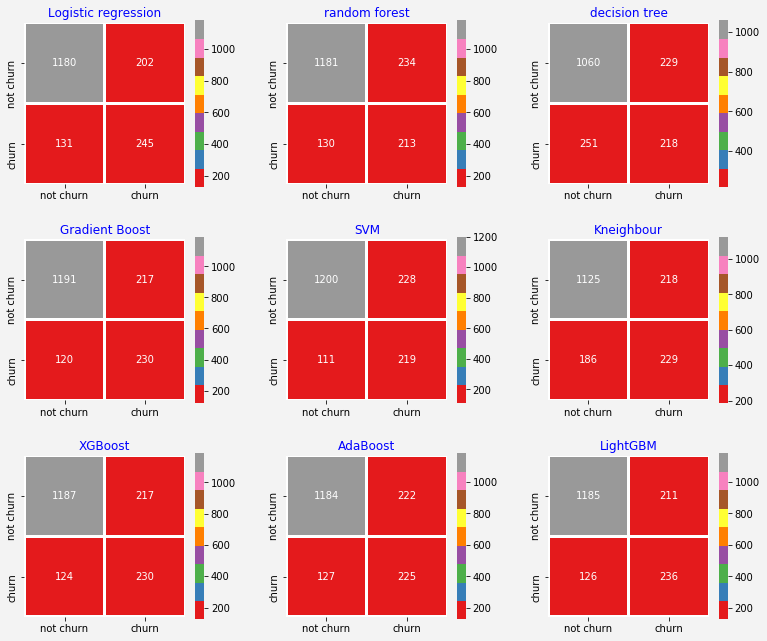

In [41]:
from sklearn.metrics import confusion_matrix
mods =["Logistic regression","random forest","decision tree","Gradient Boost","SVM","Kneighbour","XGBoost","AdaBoost","LightGBM"]
lst =[logreg,rfc,dtc,gbc,svc,knc,xbc,abc,lbc]
length=len(lst)
fig = plt.figure(figsize=(13,15))
fig.set_facecolor("#F3F3F3")
for i,j,k in itertools.zip_longest(lst,range(length),mods) :
    plt.subplot(4,3,j+1)
    predictions = i.predict(X_test)
    conf_matrix = confusion_matrix(predictions,Y_test)
    sns.heatmap(conf_matrix,annot=True,fmt = "d",square = True,
                xticklabels=["not churn","churn"],
                yticklabels=["not churn","churn"],
                linewidths = 2,linecolor = "w",cmap = "Set1")
    plt.title(k,color = "b")
    plt.subplots_adjust(wspace = .3,hspace = .3)

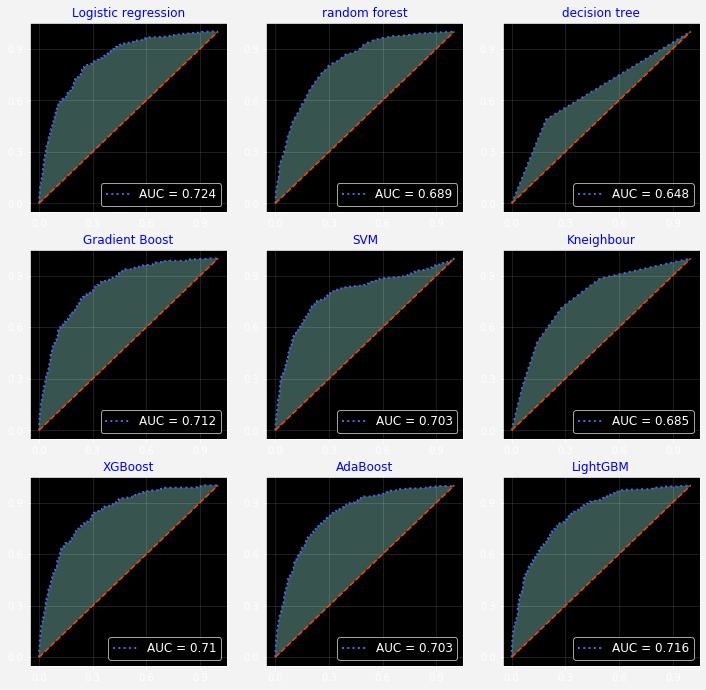

In [42]:
mods =["Logistic regression","random forest","decision tree","Gradient Boost","SVM","Kneighbour","XGBoost","AdaBoost","LightGBM"]
lst =[logreg,rfc,dtc,gbc,svc,knc,xbc,abc,lbc]
length=len(lst)
plt.style.use("dark_background")
fig = plt.figure(figsize=(12,16))
fig.set_facecolor("#F3F3F3")
for i,j,k in itertools.zip_longest(lst,range(length),mods) :
    qx = plt.subplot(4,3,j+1)
    probabilities = i.predict_proba(X_test)
    predictions   = i.predict(X_test)
    fpr,tpr,thresholds = roc_curve(Y_test,probabilities[:,1])
    plt.plot(fpr,tpr,linestyle = "dotted",
             color = "royalblue",linewidth = 2,
             label = "AUC = " + str(np.around(roc_auc_score(Y_test,predictions),3)))
    plt.plot([0,1],[0,1],linestyle = "dashed",
             color = "orangered",linewidth = 1.5)
    plt.fill_between(fpr,tpr,alpha = .4)
    plt.fill_between([0,1],[0,1],color = "k")
    plt.legend(loc = "lower right",
               prop = {"size" : 12})
    qx.set_facecolor("k")
    plt.grid(True,alpha = .15)
    plt.title(k,color = "b")
    plt.xticks(np.arange(0,1,.3))
    plt.yticks(np.arange(0,1,.3))

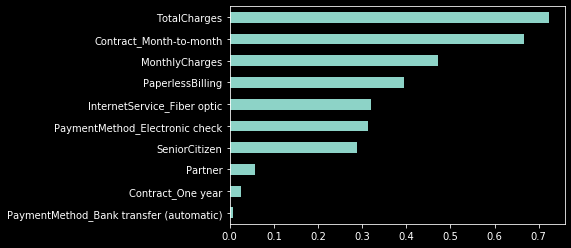

In [43]:
weights = pd.Series(logreg.coef_[0],
 index=X_train.columns.values)
weights.nlargest(10).sort_values(ascending=True).plot(kind='barh')


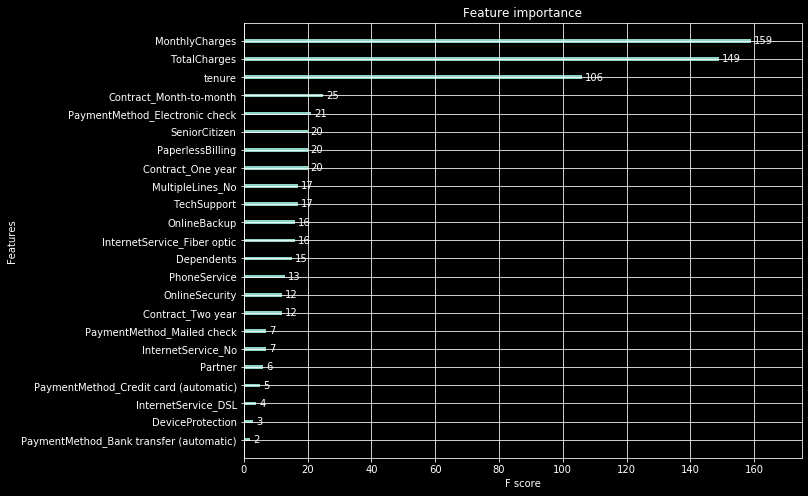

In [44]:
from xgboost import plot_importance

fig, ax = plt.subplots(figsize=(10,8))
plot_importance(xbc, ax=ax)


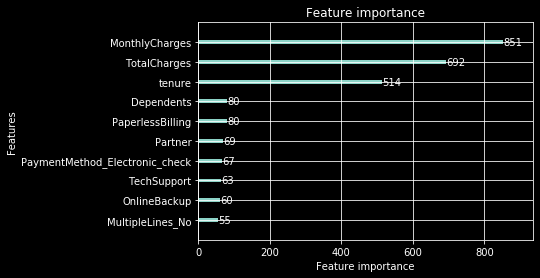

In [45]:
import lightgbm as lgb
ax = lgb.plot_importance(lbc, max_num_features=10)
plt.show()

In [46]:
print(Y_pred_logreg[0:25])

[0 0 0 1 1 0 0 1 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0]


In [47]:
churn_customer_prob = pd.DataFrame({'Predicted_proba': logreg.predict_proba(X_test)[:][:,1]
                                   , 'predicted': logreg.predict(X_test)})
churn_customer_prob

,Predicted_proba,predicted
0,0.282116,0
1,0.132878,0
2,0.187271,0
3,0.685823,1
4,0.806261,1
5,0.343788,0
6,0.424141,0
7,0.707658,1
8,0.225437,0
9,0.384094,0


In [48]:
a=np.array([0,0,0,1,0,1,1,0,1,0,0,1,-1.280248,-1.161694,-9.941941e-01,0,0,0,0,0,0,1,0,])